In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
from folium import plugins
from folium.plugins import HeatMap
import matplotlib.pyplot as plt
import itertools
from itertools import groupby
import matplotlib.colors as mcolors
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import StandardScaler
import plotly.express as px
import json
from datetime import datetime

## Motivation

Trees has many social benefits, e.g. the presence of trees can lower the criminal activity in an area. This fact was one of the inspirations of the proposed [urban forest plan](https://sfplanning.org/urban-forest-plan) in San Francisco. They list 'reduced crime rate' as one of the benefits of planting trees along the streets in the city. Two papers are also cited on the page to prove that trees really can have an influence on crime rate in a city [[1]](https://www.sciencedirect.com/science/article/abs/pii/S0169204612000977#:~:text=The%20more%20conservative%20spatially%20adjusted,roughly%2012%25%20decrease%20in%20crime.) [[2]](https://journals.sagepub.com/doi/abs/10.1177/0013916501333002#:~:text=Although%20vegetation%20has%20been%20positively,and%20less%20aggressive%20and%20violent). These studies were made based on data collected in other cities in the USA, but if planting trees worked in different cities, why not to try it in San Francisco as well? 

Since, we haven't found any resources on the correlation between tree coverage and crime rate in San Francisco, we decided to investigate this topic and find out if the above mentioned urban forest plan really lowered the crime activity in SF.

## Basic stats

This section describes the 2 datasets we were working with, starting with the street tree dataset in San Francisco. We provide the same statistics and insights to the datasets, so the reader can easily make a connectiong between the 2 datasets. Further analysis between the two can be found in the `Data analysis` section.

#### Loading the datasets (street trees and crimes)

In [2]:
# Read the data through the API of San Francisco data site
df_trees = pd.read_csv("https://data.sfgov.org/api/views/tkzw-k3nq/rows.csv?accessType=DOWNLOAD")
df_crime = pd.read_csv("https://data.sfgov.org/api/views/tmnf-yvry/rows.csv?accessType=DOWNLOAD")

#### Preprocessing (both datasets)

*Street trees dataset*

The dataset is the list of maintained street trees in San Francisco including their planting date, species, and location. Please note, that the dataset is updated quite frequently, but since we access the data through the API of the OpenSF organization, our analysis remains up-to-date and shows the visualisations with the latest data. The data is openly accessible **[here](https://data.sfgov.org/City-Infrastructure/Street-Tree-List/tkzw-k3nq)**.

We split up the `PlantDate` column to year, month, day columns in order to create monthly and yearly analysis. Also, we map the police district numbers to their names and remove trees with no location data and no valid species type.

In [3]:
# Convert date to datetime, which is easier to handle by pandas
df_trees["PlantDate"] = pd.to_datetime(df_trees["PlantDate"])

# Split the date into multiple columns
df_trees['Year'] = pd.to_datetime(df_trees['PlantDate']).dt.year
df_trees['MonthName'] = pd.to_datetime(df_trees['PlantDate']).dt.month_name()
df_trees['Month'] = pd.to_datetime(df_trees['PlantDate']).dt.month
df_trees['Day'] = pd.to_datetime(df_trees['PlantDate']).dt.day

# Mapping polic district numbers to names
num_to_distr_dict = {1: 'CENTRAL', 2: 'SOUTHERN', 3: 'BAYVIEW', 4: 'MISSION', 5: 'PARK', 6: 'RICHMOND', 7: 'INGLESIDE', 8: 'TARAVAL', 9: 'NORTHERN', 10: 'TENDERLOIN'}
df_trees = df_trees.replace({"Police Districts": num_to_distr_dict})

# Drop trees with no location data, they won't be used during the analysis
df_trees = df_trees.dropna(axis=0, subset=['Longitude','Latitude', 'Zip Codes'])

# Drop trees with non valid types
df_trees = df_trees[~df_trees.qSpecies.isin(['::', ':: To Be Determine', ':: Tree', 'Tree(s) ::'])]

*Crime dataset*

We do the same for the crime dataset, split up the `Date` column into smaller resolutions so we can do more detailed analysis on the data. Also, we delete the crimes with non-valid locations (not in the city of San Francisco) and we remove data in 2018, because that's not a full year of reported data. [Link to dataset](https://data.sfgov.org/api/views/tmnf-yvry/rows.csv?accessType=DOWNLOAD)

In [4]:
df_crime['Year'] = pd.to_datetime(df_crime['Date']).dt.year
df_crime['Month'] = pd.to_datetime(df_crime['Date']).dt.month
df_crime['Day'] = pd.to_datetime(df_crime['Date']).dt.day
df_crime['Date'] = pd.to_datetime(df_crime['Date'])

# Keep only data with valid locations
df_crime = df_crime[(df_crime.Y < 50) & (df_crime.X<-122)]
# Keep only years with full range of data
df_crime = df_crime[df_crime['Year'] < 2018]

# Drop data without no location data
df_crime = df_crime.dropna(axis=0, subset=['X','Y'])

In [5]:
# Define focus crimes to focus on during the analysis. Using the whole dataset would cause many memory errors it's also hard to handle
focuscrimes = set(['WEAPON LAWS', 'PROSTITUTION', 'DRIVING UNDER THE INFLUENCE', 'ROBBERY', 'BURGLARY', 'ASSAULT', 'DRUNKENNESS', 'DRUG/NARCOTIC', 'TRESPASS', 'LARCENY/THEFT', 'VANDALISM', 'VEHICLE THEFT', 'STOLEN PROPERTY', 'DISORDERLY CONDUCT'])

In [6]:
# Filter dataset to only keep crimes in the focus crimes categories
df_crime = df_crime[df_crime['Category'].isin(focuscrimes)]

### Street tree dataset - basic stats

#### Basic information about the dataset

Here we introduce the preprocessed dataset. Its size, the number of rows, columns and date range in which trees are registered.

In [7]:
rows = df_trees.shape[0]
columns = df_trees.shape[1]
date_from = df_trees['PlantDate'].min().strftime('%d/%m/%Y')
date_to = df_trees['PlantDate'].max().strftime('%d/%m/%Y')

print(f"The size of the full dataset is 49.2 MB.")
print(f"The preprocessed dataset has {rows} rows and {columns} columns.")
print(f"It contains entries about street trees in San Francisco planted between {date_from} and {date_to}.")

The size of the full dataset is 49.2 MB.
The preprocessed dataset has 180623 rows and 27 columns.
It contains entries about street trees in San Francisco planted between 20/10/1955 and 29/04/2022.


#### Interactive map of registered trees in San Francisco

In the next section an interactive map is shown, including all registered trees on the streets in San Francisco. This gives a great overview of the tree coverage of the city.

In [8]:
# Create list of coordinate lists for Folium to illustrate the heatmap
tree_coordinates = [[row['Latitude'],row['Longitude']] for index, row in df_trees.iterrows()]

In [9]:
# Draw map
map_trees_all = folium.Map(location=[37.758410, -122.441746],
                        tiles = "Stamen Toner",
                        zoom_start = 12)
gradient = {
    0.3: "red",
    0.5: "lime",
    0.7: "yellow",
    1: "green"
}
HeatMap(tree_coordinates, gradient=gradient, radius=1, blur=1).add_to(map_trees_all)
map_trees_all.save('trees/maps/map_trees_all.html')
map_trees_all

*Observations:* As the map shows, most of the trees are located on the east side of San Francisco, the density is a bit lower on the west side and data is missing in the public parks, probably because they are maintained and registered by an organization other than [The City Department of Public Works (DPW)](https://sfpublicworks.org/).


#### Exploratory analysis of the tree dataset

Here we conduct an exploratory analysis on the tree dataset, so we can get more insights and get familiar with the data. This section gives a deeper insight to the dataset by analysing the trees by species, years and areas.

##### *Species*
First we analyze the trees from species point of view. We're interested in the number of trees, unique species, most common species and least common species.

In [10]:
# Number of trees in the dataset
nr_trees = len(df_trees['TreeID'].unique())
print(f"The data contains {nr_trees} unique trees.")

The data contains 180623 unique trees.


In [11]:
# Number of unique tree species
tree_species = df_trees.qSpecies.unique()
print(f"There are {len(tree_species)} unique tree species registered in the dataset.")

There are 571 unique tree species registered in the dataset.


In [12]:
# List of 10 most common tree species
df_trees_grouped = df_trees.groupby("qSpecies")["TreeID"].count().reset_index().sort_values(by=['TreeID'], ascending=False)
tree_species_most_common = df_trees_grouped.head(10)
print(f"The most common tree species are the following:")
tree_species_most_common

The most common tree species are the following:


,qSpecies,TreeID
399,Platanus x hispanica :: Sycamore: London Plane,11680
338,Metrosideros excelsa :: New Zealand Xmas Tree,8757
298,Lophostemon confertus :: Brisbane Box,8735
541,Tristaniopsis laurina :: Swamp Myrtle,7400
392,Pittosporum undulatum :: Victorian Box,7191
421,Prunus cerasifera :: Cherry Plum,6700
311,Magnolia grandiflora :: Southern Magnolia,6361
61,Arbutus 'Marina' :: Hybrid Strawberry Tree,5660
207,Ficus microcarpa nitida 'Green Gem' :: Indian ...,5574
437,Prunus serrulata 'Kwanzan' :: Kwanzan Flowerin...,4004


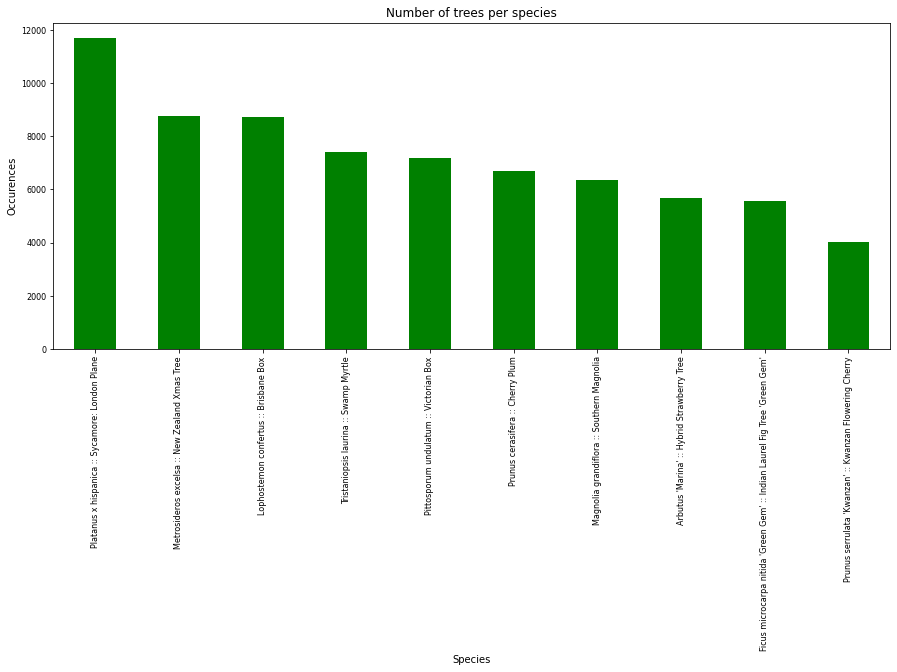

In [13]:
# Barplot of tree occurences of the most common species
tree_species_most_common = tree_species_most_common.sort_values(by=['TreeID'], ascending=False)

ax = tree_species_most_common.plot(x ='qSpecies', y='TreeID', kind = 'bar', legend=None, \
title='Number of trees per species', xlabel='Species', ylabel='Occurences', figsize=(15, 6), 
fontsize=8, colormap="ocean", rot=90)
plt.savefig('trees/images/trees_per_species_bar.png', bbox_inches='tight')

*Observations:* The plot shows that the **most common** tree species in San Francisco is *Platanus x hispanica :: Sycamore: London Plane* with *11680* occurences. Overall, it shows the 10 most common tree species and their occurences in San Francisco.


In [14]:
# Generate maps for the most common species to include on the website

for index, species in enumerate(tree_species_most_common['qSpecies'].to_list()):
    filtered = df_trees[df_trees['qSpecies'] == species]
    coordinates = [[row['Latitude'],row['Longitude']] for index, row in filtered.iterrows()]
    map_t = folium.Map(location=[37.758410, -122.441746],
                        tiles = "Stamen Toner",
                        zoom_start = 12)
    gradient = {
        0.3: "red",
        0.5: "lime",
        0.7: "yellow",
        1: "green"
    }
    HeatMap(coordinates, gradient=gradient, radius=2, blur=1).add_to(map_t)
    map_t.save(f'trees/maps/map_species_{index+1}.html')

In [15]:
# Most occuring tree species
most_common = df_trees_grouped.iloc[0]

# Least occuring tree species
least_common_count = df_trees_grouped.iloc[-1][1]

least_common = df_trees_grouped[df_trees_grouped['TreeID'] == least_common_count]['qSpecies'].to_list()

print(f"The most common tree species in San Francisco is {most_common[0]} with {most_common[1]} tree occurence.")
print(f"The least common tree species in San Francisco are e.g. \n{chr(10).join(least_common[:6])} with only {least_common_count} tree occurence.")

The most common tree species in San Francisco is Platanus x hispanica :: Sycamore: London Plane with 11680 tree occurence.
The least common tree species in San Francisco are e.g. 
Yucca aloifolia :: Spanish bayonet
Alnus rubra :: Red Alder
Brahea brandegeei :: San Jose hesper palm
Araucaria bidwillii :: Bunya Bunya
Acer campestre :: Hedge Maple
Aesculus spp :: Horsechestnut with only 1 tree occurence.


##### *Yearly development*

In this section we analyse the tree planting development in the city and the progress they made over the year. We're interested in any peaks and valleys in the registered time period.

In [16]:
# Number of trees planted per year, month, day
df_trees_yearly = df_trees.groupby(["Year"])["TreeID"].count().reset_index()
df_trees_monthly = df_trees.groupby(["Year","Month"])["TreeID"].count().reset_index()
df_trees_daily = df_trees.groupby(["Year","Month","Day"])["TreeID"].count().reset_index()

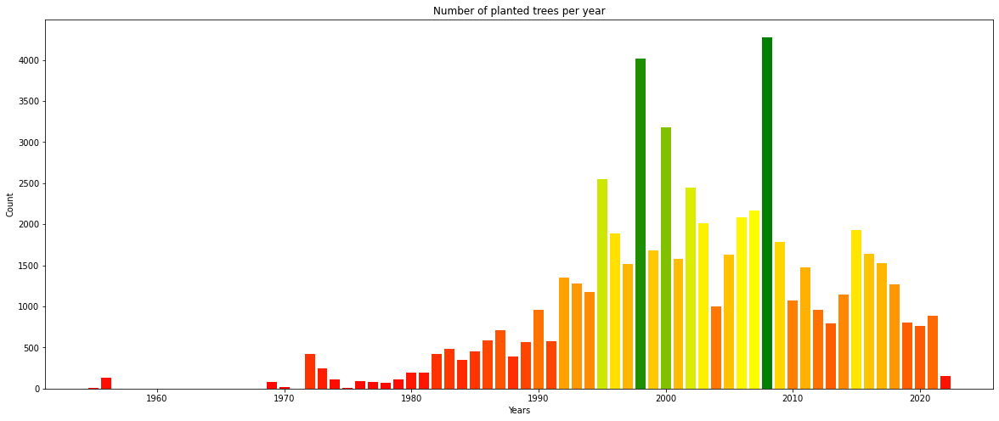

In [17]:
# Draw bar chart for yearly count
cmap = mcolors.LinearSegmentedColormap.from_list("", ["red", "yellow", "green"])
plt.figure(figsize=(20,8))
plt.title(f"Number of planted trees per year")
plt.xlabel('Years')
plt.ylabel('Count')
plt.bar(df_trees_yearly['Year'], df_trees_yearly['TreeID'], color=cmap(df_trees_yearly['TreeID'].values/df_trees_yearly['TreeID'].values.max()))
plt.savefig('trees/images/trees_per_year_bar.png', bbox_inches='tight')

*Observations:* The figure shows the number of trees planted in each year in San Francisco. The most trees were planted in 2008, when they planted 4278 trees. In 1955 only 6 trees were planted, which is the lowest amount in the registered time period.

In [18]:
# Get years with max and min count
# Sort df by count
df_trees_yearly_sorted_count = df_trees_yearly.sort_values(by=['TreeID'])

# Max and minimum number of trees planted
max_trees = df_trees_yearly_sorted_count.iloc[-1]
min_trees = df_trees_yearly_sorted_count.iloc[0]

print(f"In {max_trees[0].astype(int)} {max_trees[1].astype(int)} trees were planted, which is the hightest amount in the registered time period.")
print(f"In {min_trees[0].astype(int)} {min_trees[1].astype(int)} trees were planted, which is the lowest amount in the registered time period.")

In 2008 4278 trees were planted, which is the hightest amount in the registered time period.
In 1955 6 trees were planted, which is the lowest amount in the registered time period.


In [19]:
# Get average planted trees by year, month and day

mean_yearly = int(df_trees_yearly['TreeID'].mean())
mean_monthly = int(df_trees_monthly['TreeID'].mean())
mean_daily = int(df_trees_daily['TreeID'].mean())

print(f"On average, {mean_yearly} trees were planted yearly, {mean_monthly} trees were planted monthly and {mean_daily} were planted daily.")

On average, 1077 trees were planted yearly, 99 trees were planted monthly and 8 were planted daily.


* **Animation of planting the trees over the years**

Here we create a movie which is a good representation of the planted trees over the years. The movie shows the planted trees in each year between 1972 and 2022. (We decided to show the movie from 1972 and not 1955, because from 1972 the city started planting trees in each year without gap, before that, the planting activity was not that significant.) 

In [20]:
# Create a copy of the original trees dataframe
df_trees_animation = df_trees.copy()

In [21]:
# Define year range to investigate
start_year = 1972
end_year = 2022

# Year range to investigate
index = range(start_year, end_year+1)
# Keep only necessary columns
df_trees_animation = df_trees_animation[['Latitude', 'Longitude', 'Year']]

# Construct heatmap data with list comprehension
# Iterate through a temporary dataframe which contains the trees for a particular year; 
# Save the coordinates in a list for that day for each tree; 
# Moving on to the next year and start a new list etc.
tree_coords = [[[row['Latitude'],row['Longitude']] for index, row in df_trees_animation[df_trees_animation['Year'] == year].iterrows()] for year in index]

In [22]:
# Setup heatmap, set location to San Francisco

map_planting_animation = folium.Map(location=[37.758410, -122.441746],
                        tiles = "Stamen Toner",
                        zoom_start = 12)

# Create movie with the geodata
hm_animation = plugins.HeatMapWithTime(tree_coords, index=list(index), auto_play=True, max_opacity=0.8, min_speed=9, gradient=gradient, radius=3)
# Add movie to the map
hm_animation.add_to(map_planting_animation)
map_planting_animation.save('trees/maps/map_trees_animation.html')
# Show map
map_planting_animation

*Observations:* We can see that most of the time the trees were scattered over the city. Although there are some years we can highlight, when the organization focused on specific areas or districts in San Francisco. For example, in *2006* the city really focused on planting trees along the *25th, 26th and 27th Avenue in Taraval* and along the *Ingalls street in Bayview*. In *2007* many trees were planted along the *28th and 24th Avenue in Taraval* and along the *main streets of the Southern districts*. In *2008*, most of the trees were planted in *Richmond disctrict (just above the Golden Gate Park)*, the street pattern is outlined clearly as well. These are the highlights that worth mentioning, but each year can be investigated by playing the movie below, pausing it, step between the years and zoom in on the map to have closer look.

* **Average number of trees per year by species and by adding its standard deviation.**

By calculating the standard daviation of the number of trees over the years, we can observe the extent of the difference of number the planted trees compared to the average.


Due to the large selection of tree species (571 unique species in total), we decided to work with the most common species which are listed in the following cell:

In [23]:
# Create a plot about the average number of trees per year by species and by adding its standard deviation.

# Define focus species, which are the 10 most common species
focus_species = tree_species_most_common['qSpecies'].to_list()
print(f"The focus species are the following: \n{chr(10).join(focus_species)}")

The focus species are the following: 
Platanus x hispanica :: Sycamore: London Plane
Metrosideros excelsa :: New Zealand Xmas Tree
Lophostemon confertus :: Brisbane Box
Tristaniopsis laurina :: Swamp Myrtle
Pittosporum undulatum :: Victorian Box
Prunus cerasifera :: Cherry Plum
Magnolia grandiflora :: Southern Magnolia
Arbutus 'Marina' :: Hybrid Strawberry Tree
Ficus microcarpa nitida 'Green Gem' :: Indian Laurel Fig Tree 'Green Gem'
Prunus serrulata 'Kwanzan' :: Kwanzan Flowering Cherry


In [24]:
# Create df that only contains species from the focus list
df_tree_focus = df_trees[df_trees['qSpecies'].isin(focus_species)]

In [25]:
trees_species_year_count = df_tree_focus[['qSpecies', 'Year', 'TreeID']].groupby(['qSpecies', 'Year'])['TreeID'].agg(lambda x: x.nunique()).reset_index()
average_per_species_sorted = trees_species_year_count.groupby('qSpecies')['TreeID'].agg(['mean', 'std']).reset_index().sort_values('mean', ascending=False)

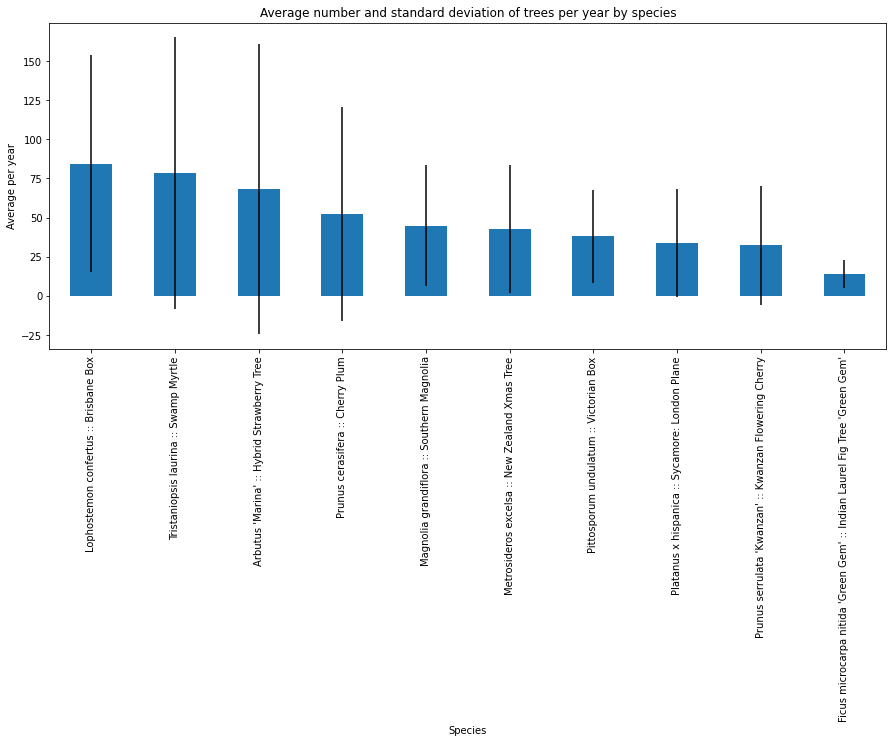

In [26]:
# Plot chart
average_per_species_sorted.plot(x ='qSpecies', y='mean', yerr='std', kind = 'bar', legend=None, \
title='Average number and standard deviation of trees per year by species', xlabel='Species', ylabel='Average per year', figsize=(15, 6))
plt.savefig('trees/images/trees_avg_per_year_std_bar.png', bbox_inches='tight')

*Observations:* The figure illustrates the average number of planted trees per year by species and their standard deviations as error bars. As standard deviation is the quantity expressing how much the members of a group differ from the mean value for the group, we can conclude here, that for the trees in the *Arbutus Marina* species, the planted trees per year strongly differ from the mean of the yearly count. We can notice the same pattern in all the selected species, although in the case of *Ficus microcarpa nitida* it's not that significant.

* **Year-by-year development of the focus tree species**
Another interesting area to investigate is the year-by-year development of the tree species.

In [27]:
def trees_yearly_dev():
    # Create bar charts displaying the year-by-year development of the focus tree species

    # Create list of df-s for each focus species
    df_focus_species = [df_trees[df_trees['qSpecies'] == species].groupby('Year')['TreeID'].count().reset_index().sort_values(by=['Year']) for species in focus_species]

    # Define subplot props
    nr_cols = 5
    nr_rows = np.ceil(len(focus_species)/nr_cols).astype(int)
    plt.figure(figsize=(24,12)) 

    # Generate subplots
    for index, species in enumerate(focus_species):
        df_focus = df_focus_species[index]
        plt.subplot(nr_rows, nr_cols, index+1)
        #plt.xticks(rotation=x_rotation)
        plt.title(species, fontsize=10)
        plt.xlabel('Years', fontsize=12)
        plt.ylabel('Count', fontsize=12)
        plt.bar(df_focus['Year'], df_focus['TreeID'], color=cmap(df_focus['TreeID'].values/df_focus['TreeID'].values.max()))


    plt.suptitle('Yearly development of planted trees across the focus tree species', fontsize=16)
    plt.tight_layout()
    plt.savefig('trees/images/species_yearly_dev_bar.png', bbox_inches='tight')
    plt.show()

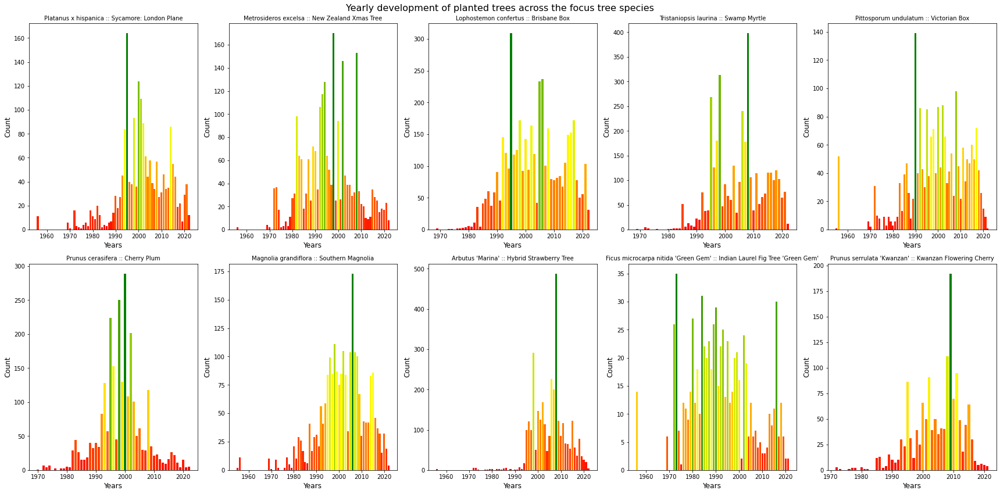

In [28]:
trees_yearly_dev()

*Observations:* On the figure we can see how many trees were planted for each species per year. The green color indicates high amount of planted trees in the year, read indicates low amount and the yellow color transitions for the amounts in between.

These are the most interesting observations we can read from these plots:
- *Ficus microcarpa nitida 'Green Gem' :: Indian Laurel Fig Tree 'Green Gem'*: Despite the low amount of trees planted from this species in general (maximum is less than 40 in a year), the number of trees per year was quite consistent and in most of the years, the amount was close to the max number of planted trees from this species. Seeing the consistency across the years also supported by the standard deviation of this species, shown in the previous figure, as this was the type which had the lowest standard deviation, meaningly the fluctuation of the number of planted trees throughout the years is low.
- *Arbutus 'Marina' :: Hybrid Strawberry Tree*: As opposed to the previously introduced species (Ficus), this plot has a well distinguishable peak in 2008, where extreme amount of trees were planted, nearly 500. In other years, the amount remained close to 100. This can be read (or at least suspected) by looking at the previous figure, because this species has the largest standard deviation, meaningly the tree counts are mostly far from the mean, which is understandable, since the mean is highly influenced by this peak.
- *Prunus cerasifera :: Cherry Plum*: Interestingly, this plot has a bell shape, which means that in the early years they did not plant that many trees of this species, but they focused on planting trees between 1995 and 2005, gradually increasing, then decreasing the number of planted trees. After 2005, the amount decreased gradually and less than 50 trees were planted a year.

* **Outliers in total number of trees planted per year using window rolling mean and window rolling standard deviation**
We could see from the previous analyzations that there are some year that were exceptional in terms on planting trees. Therefore, next we investigate outliers across all plated trees, not restricted to specific species. The way we do that is calculating the outliers first with [window rolling calculations](https://towardsdatascience.com/dont-miss-out-on-rolling-window-functions-in-pandas-850b817131db) and finding months that fall outside of the boundaries. Then, we calculate the outliers again, but this time with the [IsolationForest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) algorithm and lastly we compare the 2 sets of months and investigate those specific dates that were found by both methods.

> So here we calculate the mean for 24 months rolling (moving) window and get the lower and upper threshold by extracting or adding the standard deviation of that window of the data. The we highlight the outliers that fall outside of the defined area. More info and examples for rolling calculations can be found [here](https://towardsdatascience.com/dont-miss-out-on-rolling-window-functions-in-pandas-850b817131db).

In [29]:
# Prepare df for visualizing outliers
df_trees_outliers = df_trees[["TreeID", "PlantDate"]]

# Cut the date to months
df_trees_outliers["PlantYearMonth"] = df_trees_outliers["PlantDate"].dt.to_period('M').dt.to_timestamp()

df_trees_outliers = df_trees_outliers.groupby("PlantYearMonth")["TreeID"].count().reset_index()
df_trees_outliers.set_index("PlantYearMonth", inplace=True)

/shared-libs/python3.7/py-core/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


In [30]:
# Define a rolling window of 24 months (2 years)
window = 24

# Lambda function that returns with the upper and lower boundaries while rolling the window through the data
get_thresholds = lambda data: (data.rolling(window).mean() - 3 * data.rolling(window).std(), data.rolling(window).mean() + 3 * data.rolling(window).std())
lower_threshold, upper_threshold = get_thresholds(df_trees_outliers["TreeID"])

# Get the outliers
outliers = (df_trees_outliers["TreeID"] > upper_threshold) | (df_trees_outliers["TreeID"] < lower_threshold)

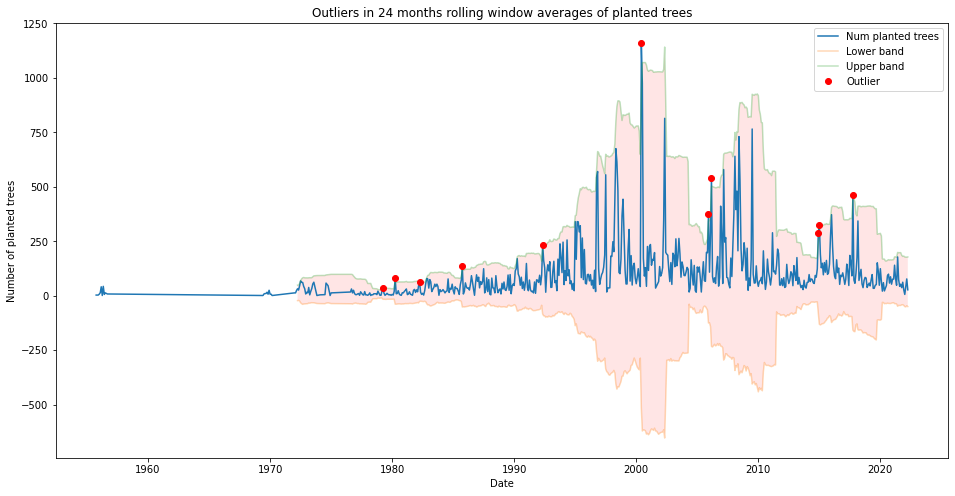

Number of outliers: 11
Number of all data points: 593


In [31]:
# Plot the rolling threshold area and outliers
fig, ax = plt.subplots(1,1, figsize=(16,8))

ax.plot(df_trees_outliers.index, df_trees_outliers, label="Num planted trees")
ax.plot(df_trees_outliers.index, lower_threshold, label="Lower band", alpha=0.3)
ax.plot(df_trees_outliers.index, upper_threshold, label="Upper band", alpha=0.3)
ax.fill_between(df_trees_outliers.index, upper_threshold, lower_threshold, facecolor="red", alpha=0.1)
ax.plot(df_trees_outliers.index[outliers], df_trees_outliers[outliers], "ro", label="Outlier")
ax.set_xlabel("Date")
ax.set_ylabel("Number of planted trees")
ax.set_title("Outliers in 24 months rolling window averages of planted trees")
ax.legend()
plt.savefig('trees/images/outliers_rolling.png', bbox_inches='tight')
plt.show()

num_outliers = len(outliers[outliers])
num_data_points = len(df_trees_outliers)
print(f"Number of outliers: {num_outliers}\nNumber of all data points: {num_data_points}")

*Observations:* Firstly, the boundaries are defined for a 24 months rolling window and with the help of this window's standard deviations, the lower theshold (by extracting the std from the mean) and upper threshold (by adding the std to the mean) are defined. The outliers are incidated with red dots on the plot and we can see that in the year of 2000 exceptionally large amount of trees were planted compared to the average. There are other outliers as well, but they are not that significant. There are **11 outliers** in total out of the 593 total data points.

* **Finding the outliers with IsolationForest**
> Sklearn's [IsolationForest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) returns the anomaly score of each sample using the IsolationForest algorithm.
> We are calculating the outliers with another method as well and check the ones that were found by both methods.

In [32]:
# Executing the IsolationForest algorithm on a copy of the previous dataframe
df_trees_outliers_2 = df_trees_outliers.copy()

outliers_fraction = num_outliers/num_data_points
scaler = StandardScaler()
np_scaled = scaler.fit_transform(df_trees_outliers_2.values.reshape(-1, 1))
data = pd.DataFrame(np_scaled)

model = IsolationForest(contamination=outliers_fraction)
model.fit(data)

df_trees_outliers_2['anomaly'] = model.predict(data)

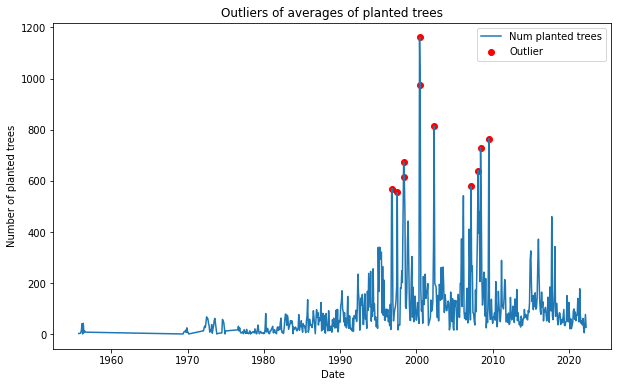

In [33]:
# Plot the outliers
fig, ax = plt.subplots(figsize=(10,6))

# Getting the outliers
outliers_iforest = df_trees_outliers_2.loc[df_trees_outliers_2['anomaly'] == -1, ['TreeID']]

ax.plot(df_trees_outliers_2.index, df_trees_outliers_2['TreeID'], label = 'Num planted trees')
ax.scatter(outliers_iforest.index, outliers_iforest['TreeID'], color='red', label = 'Outlier')
ax.set_xlabel("Date")
ax.set_ylabel("Number of planted trees")
ax.set_title("Outliers of averages of planted trees")
plt.legend()
plt.savefig('trees/images/outliers_iforest.png', bbox_inches='tight')
plt.show()

*Observations:* The algorithm found 11 anomalies, but interestingly, these dates are different from the other 11 outliers found by the rolling method.

In [34]:
# Get the outliers that were found by both methods
matching_outliers = set(outliers_iforest.index) & set(outliers[outliers].index)

print("Outliers that both method could find:")
for match in matching_outliers:
    print(f"Timestamp: {match} Count: {outliers_iforest.loc[match]['TreeID']}")

Outliers that both method could find:
Timestamp: 2000-06-01 00:00:00 Count: 1161


*Observations:* The only matching month for outliers is *2000 June*. We tried to find resources on what happened in the highlighted month (June 2000), but we haven't found any articles that would support that a huge tree planting activity happened in that month, so we just conclude that in that month, exceptionally many trees were planted.

##### *Trees per area*

Lastly, we analyse the location and distribution of the trees in the city by visualizing them in Police Districts and calculating their density in 100mx100m squares of the city.

* **Visualize trees per Police Disctrict**

A way to examine the tree population in San Francisco is to visualize their distribution across the Police Districts. Fortunately, the dataset we're working with provides that information about the individual tree. This type of visualisation can help us later while investigated the relevance of trees in a particular area in terms of crime occurences.

In [35]:
# Save geodata of districts
with open('../sfpd.geojson') as file:
    districts = json.load(file)

In [36]:
# Calculate how many trees are placed in each district
df_trees_districts = df_trees.groupby('Police Districts')['TreeID'].count().reset_index().sort_values(by=['TreeID'])
df_trees_districts = df_trees_districts.rename(columns={"TreeID": "Count"})

In [37]:
# Plot the map that indicates the number of trees per police district
fig = px.choropleth_mapbox(df_trees_districts, geojson=districts, locations='Police Districts', color='Count',
                           range_color=(df_trees_districts['Count'].min(), df_trees_districts['Count'].max()),
                           mapbox_style="carto-positron",
                           zoom=11, center = {"lat": 37.773972, "lon": -122.431297},
                           color_continuous_scale="Tealgrn",
                           opacity=0.4,
                           labels={'Value':'The parameter'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.write_html("trees/maps/tree_count_district.html")
fig.show()

*Observations:* This interactive map shows the number of trees planted in each Police District, the darker the blue color, the more trees are planted there. *Tip: Hovering over an area gives more details about the district.*

By looking at the map, we can conclude that the least amount of trees are in the Tenderloid district (1001) and most are located in Taraval (28551) and Ingleside (29738). Although, the reason behind these results can be the size of these areas. Tenderloid is really small compared to the latter districts, so it physically can't contain a lot of trees compared to the bigger districts. So, a more relevant visualisation here can be the density of trees in 100mx100m squares in San Francisco, because despite the low count in Tenderloin, the density might be higher than in the districts with bigger area.

* **Divide SF trees into a grid 100m*100m and show density**

Here we calculate the tree density for each sqaure in San Francisco because of the above mentioned reasons.

In [38]:
# Define boundaries of the investigated area to be the same as the crime area
lat_min = df_crime["Y"].min()
lat_max = df_crime["Y"].max()

lon_min = df_crime["X"].min()
lon_max = df_crime["X"].max()

df_trees_grid = df_trees[(df_trees["Latitude"] <= lat_max) & (df_trees["Latitude"] >= lat_min) & (df_trees["Longitude"] <= lon_max) & (df_trees["Longitude"] >= lon_min)]

In [39]:
# Get counts in each square
trees_count, trees_lon, trees_lat = np.histogram2d(df_trees_grid["Latitude"], df_trees_grid["Longitude"], bins = [130,125])

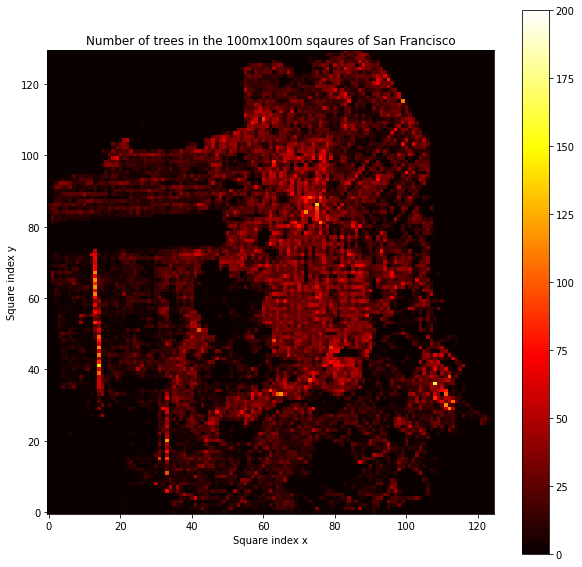

In [40]:
# Plot figure of 100mx100m squares
plt.figure(figsize=(10,10))
plt.xlabel('Square index x')
plt.ylabel('Square index y')
plt.title('Number of trees in the 100mx100m sqaures of San Francisco')
plt.imshow(trees_count, cmap='hot',vmax=200, origin='lower')
plt.colorbar()
plt.savefig('trees/images/tree_density_100x100.png', bbox_inches='tight')
plt.show()

*Observations:* The figure illustrates the density of trees in 100mx100m squares, the ligher the color, the higher the tree density in that area. 

Just below Tenderloin, on the edge of the Southern, Northern and Mission districts, the tree density is quite high. Our previous assumption that Tenderloin might have high tree coverage is not true, that makes Tenderloin a district with low amount of trees with low coverage.

Although this visualisation shows other interesting insights on the tree distribution in specific areas. There is a clear pattern of 2 vertical streets full of trees in the lower left corner in Taraval. Those streets are *Sunset Boulevard* and the *Junipero Serra Boulevard*. Sunset Boulevard is famous of its [beautiful trees and bushes](https://www.sfparksalliance.org/our-parks/parks/sunset-blvd) along the road, which gives a great free time activity environment for runners, cyclists, families etc. The final section of the Junipero Serra Boulevard is also [aligned with trees](https://en.wikipedia.org/wiki/Junipero_Serra_Boulevard) quite densly, but that's only true for its final section, as we can read it from the picture as well.

#### Highlights of Basic stats of the tree dataset

San Francisco's street tree dataset contains `180611` trees that has valid location data and species defined. Most of the trees are located on the east side of San Francisco. The most common tree species in San Francisco is `Platanus x hispanica :: Sycamore: London Plane` with `11680` occurences. The data contains `571 species` in total across `180611` trees. The year with the most tree planted was `2008` with `4278` trees. On average, `1077` trees were planted per year, `99 per month` and `8 per day`. 

*Yearly development of the most common species and some highlights explained*:

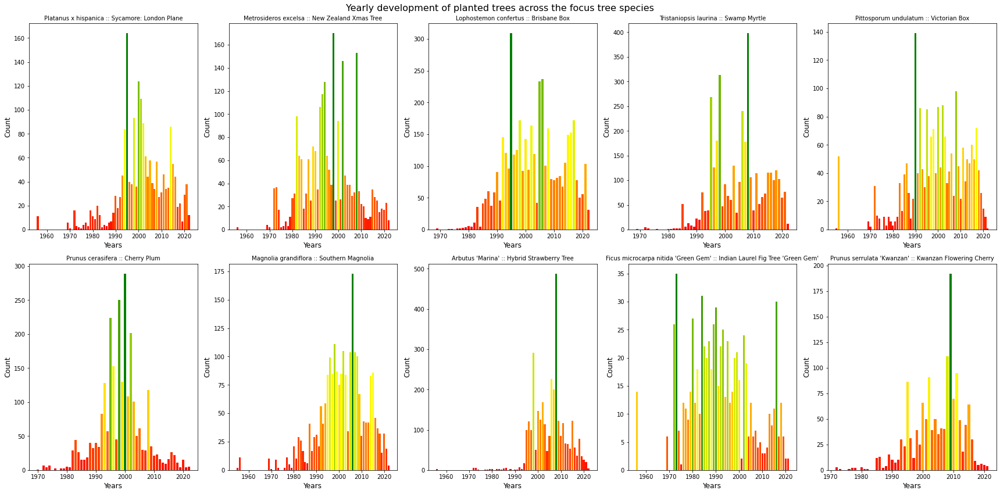

In [41]:
# Plot the yearly development of trees
trees_yearly_dev()

* *Ficus microcarpa nitida 'Green Gem' :: Indian Laurel Fig Tree 'Green Gem'*: Despite the low amount of trees planted from this species in general (maximum is less than 40 in a year), the number of trees per year was quite consistent and in most of the years, the amount was close to the max number of planted trees from this species.
* *Arbutus 'Marina' :: Hybrid Strawberry Tree*: As opposed to the previously introduced species (Ficus), this plot has a well distinguishable peak in 2008, where extreme amount of trees were planted, nearly 500. In other years, the amount remained close to 100.
* *Prunus cerasifera :: Cherry Plum*: Interestingly, this plot has a bell shape, which means that in the early years they did not plant that many trees of this species, but they focused on planting trees between 1995 and 2005, gradually increasing, then decreasing the number of planted trees. After 2005, the amount decreased gradually and less than 50 trees were planted a year.

To conclude, fortunately, the street tree dataset is well-maintained and includes location data, so we were able to create interesting visualisations. We also learned about the different species planted in the city and see the trend of planting many trees each year and having some years with exceptionally high number of planted trees. More insights about the data can be found on the project's [website](https://noramurakozy.github.io/SDA_web/).

### Crime dataset - basic stats

#### Basic information about the dataset

Here we introduce the preprocessed dataset. Its size, the number of rows, columns and date range in which trees are registered.

In [42]:
rows = df_crime.shape[0]
columns = df_crime.shape[1]
date_from = df_crime['Date'].min().strftime('%d/%m/%Y')
date_to = df_crime['Date'].max().strftime('%d/%m/%Y')

print(f"The size of the full dataset is 538 MB.")
print(f"The preprocessed dataset has {rows} rows and {columns} columns.")
print(f"It contains entries about police interactions in San Francisco between {date_from} and {date_to}.")

The size of the full dataset is 538 MB.
The preprocessed dataset has 1214682 rows and 38 columns.
It contains entries about police interactions in San Francisco between 01/01/2003 and 31/12/2017.


#### Exploratory analysis

Here we conduct an exploratory analysis on the crime dataset, so we can get more insights and get familiar with the data. This section gives a deeper insight to the dataset by analysing the crimes by category, years and areas.

***Categories***

First we analyze the crimes from categories point of view. We're interested in the number of crimes, categories, most common categories and least common categories.

In [43]:
# Start with the overall length by counting the ID's 
nr_crimes = len(df_crime['IncidntNum'].unique())
print(f"The dataset contains {nr_crimes} unique crimes.")

The dataset contains 1064315 unique crimes.


In [44]:
# Number of unique crime categories
crime_types = df_crime['Category'].unique()
print(f"There are {len(crime_types)} unique crime types in the dataset.")
print(f"Note that we filtered down the dataset to only include crimes from the focuscrimes.")

There are 14 unique crime types in the dataset.
Note that we filtered down the dataset to only include crimes from the focuscrimes.


In [45]:
# List of 10 most common crime types
df_crimes_grouped = df_crime.groupby("Category")["IncidntNum"].count().reset_index().sort_values(by=['IncidntNum'], ascending=False)
most_common_crimes = df_crimes_grouped.head(10)
print(f"The most common crime types are the following:")
most_common_crimes

The most common crime types are the following:


,Category,IncidntNum
6,LARCENY/THEFT,464337
0,ASSAULT,163151
12,VEHICLE THEFT,124744
4,DRUG/NARCOTIC,116345
11,VANDALISM,111932
1,BURGLARY,88970
8,ROBBERY,53414
13,WEAPON LAWS,20396
10,TRESPASS,18679
7,PROSTITUTION,16451


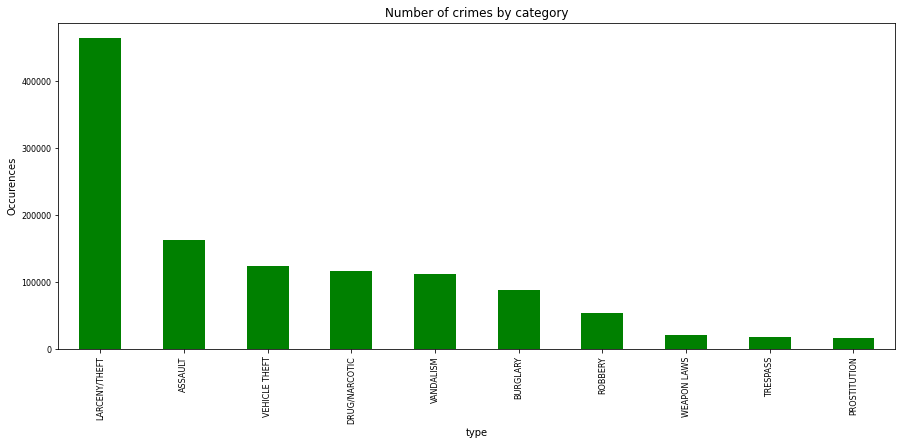

In [46]:
# Barplot of crime occurences of the most common species
most_common_crimes = most_common_crimes.sort_values(by=['IncidntNum'], ascending=False)

ax = most_common_crimes.plot(x ='Category', y='IncidntNum', kind = 'bar', legend=None, \
title='Number of crimes by category', xlabel='type', ylabel='Occurences', figsize=(15, 6), 
fontsize=8, colormap="ocean", rot=90)
plt.savefig('crimes/images/crime_type_bar.png', bbox_inches='tight')

*Observations:* The plot shows that the **most common** crime category in San Francisco is *LARCENY/THEFT* with *464337* occurences. On the other hand, *PROSTITUTION* has the least amount of occurences, around 100000.

In [47]:
# Generate maps for the most common crime categories to include them on the website
for index, category in enumerate(most_common_crimes['Category'].to_list()):
    filtered = df_crime[df_crime['Category'] == category]
    coordinates = [[row['Y'],row['X']] for index, row in filtered.iterrows()]
    map_c = folium.Map(location=[37.758410, -122.441746],
                        tiles = "Stamen Toner",
                        zoom_start = 12)
    gradient = {
        0.3: "red",
        0.5: "lime",
        0.7: "yellow",
        1: "green"
    }
    HeatMap(coordinates, gradient=gradient, radius=2, blur=1).add_to(map_c)
    map_c.save(f'crimes/maps/map_crime_{index+1}.html')

In [48]:
# Most occuring crimes
most_common = df_crimes_grouped.iloc[0]

# Least occuring crimes
least_common = df_crimes_grouped.iloc[-1]

print(f"The most common crime type in San Francisco is {most_common[0]} with {most_common[1]} occurances.")
print(f"The least common crime types in San Francisco is {least_common[0]} with only {least_common[1]} occurance.")

The most common crime type in San Francisco is LARCENY/THEFT with 464337 occurances.
The least common crime types in San Francisco is DRIVING UNDER THE INFLUENCE with only 5560 occurance.


***Yearly development***

In this section we analyse the crime rate development in the city, we're interested in any peaks and valleys in the investigated time period.

In [49]:
# Number of crimes per year, month, day
df_crimes_yearly = df_crime.groupby(["Year"])["IncidntNum"].count().reset_index()
df_crimes_monthly = df_crime.groupby(["Year","Month"])["IncidntNum"].count().reset_index()
df_crimes_daily = df_crime.groupby(["Year","Month","Day"])["IncidntNum"].count().reset_index()

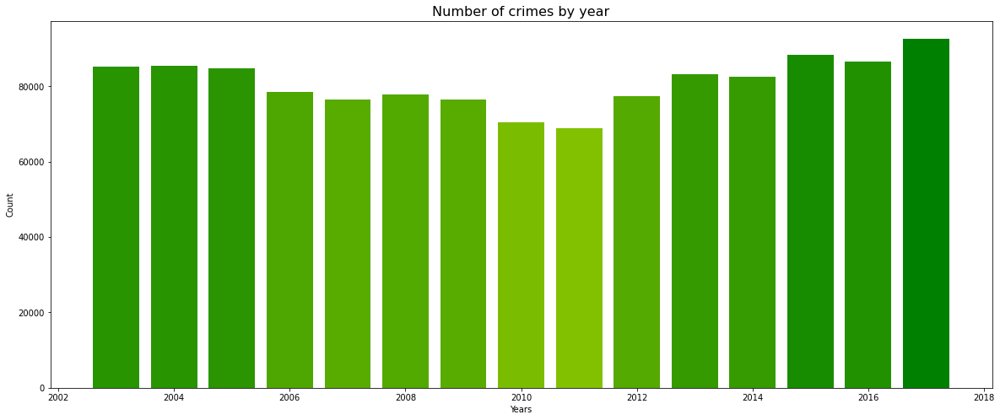

In [50]:
# Draw bar chart for yearly count
cmap = mcolors.LinearSegmentedColormap.from_list("", ["red", "yellow", "green"])
plt.figure(figsize=(20,8))
plt.title(f"Number of crimes by year", fontsize=16)
plt.xlabel('Years')
plt.ylabel('Count')
plt.bar(df_crimes_yearly['Year'], df_crimes_yearly['IncidntNum'], color=cmap(df_crimes_yearly['IncidntNum'].values/df_crimes_yearly['IncidntNum'].values.max()))
plt.savefig('crimes/images/crimes_per_year_bar.png', bbox_inches='tight')

*Observations:* The figure shows the number of crimes in each year in San Francisco. Most of the crimes happened in 2017 with around 90000 incidents. In 2011 only ~70000 crimes happened, which is the lowest amount in the registered time period.

In [51]:
# Get years with max and min count
# Sort df by count
df_crimes_monthly_sorted_count = df_crimes_yearly.sort_values(by=['IncidntNum'])

# Max and minimum number of crimes
max_crimes = df_crimes_monthly_sorted_count.iloc[-1]
min_crimes = df_crimes_monthly_sorted_count.iloc[0]

print(f"In {max_crimes[0].astype(int)} {max_crimes[1].astype(int)} crime incidents occured, which is the hightest amount in the registered time period.")
print(f"In {min_crimes[0].astype(int)} {min_crimes[1].astype(int)} crime incidents occured, which is the lowest amount in the registered time period.")

In 2017 92696 crime incidents occured, which is the hightest amount in the registered time period.
In 2011 68910 crime incidents occured, which is the lowest amount in the registered time period.


In [52]:
# Get average police interactions by year, month and day

mean_yearly = int(df_crimes_yearly['IncidntNum'].mean())
mean_monthly = int(df_crimes_monthly['IncidntNum'].mean())
mean_daily = int(df_crimes_daily['IncidntNum'].mean())

print(f"On average, {mean_yearly} crimes occured yearly,\n{mean_monthly} crimes occured monthly and\n{mean_daily} occured daily.")

On average, 80978 crimes occured yearly,
6748 crimes occured monthly and
221 occured daily.


* **Animation of crime occurences over the years**

Here we create a movie which is a good representation of the crimes occured over the years. The movie shows the crimes in each year between 2011 and 2017. We decided to examine this year range, because we can see a gradual increase starting from the year of 2011. Also, we decided to only investigate the `LARCENY/THEFT` category as the most common type of crime, because that would show a great trend of the changes in the crime categories.

In [53]:
# Create copy of crime dataframe
df_crime_animation = df_crime.copy()
# Filter dataset to category to investigate
df_crime_animation = df_crime_animation[df_crime_animation['Category'] == 'LARCENY/THEFT']

In [54]:
# Define year range to investigate
start_year = 2011
end_year = 2017

# Year range to investigate
index = range(start_year, end_year+1)
# Keep only necessary columns
df_crime_animation = df_crime_animation[['X', 'Y', 'Year']]

# create the coordinates for each interaction
crime_coords = [[[row['Y'],row['X']] for index, row in df_crime_animation[df_crime_animation['Year'] == year].iterrows()] for year in index]

# draw the map
map_crime_animation = folium.Map(location=[37.758410, -122.441746],
                        tiles = "CartoDB Positron",
                        zoom_start = 12)

# Create movie with the geodata
hm_animation_crime = plugins.HeatMapWithTime(crime_coords, index=list(index), auto_play=True, max_opacity=0.8, min_speed=9, gradient=gradient, radius=3)
# Add movie to the map
hm_animation_crime.add_to(map_crime_animation)
map_crime_animation.save('crimes/maps/map_crimes_animation.html')

# Show movie
map_crime_animation

*Observations:* The most common area of the investigated crime basically remaines the same - north-west section of the city - over the years, but the location of the incidents at the least frequented places changes from year to year.

* **Average number of crimes per category over the years and their standard deviations**

By calculating the standard daviation of the number of crimes over the years, we can observe the extent of the difference of the number of crime incidents compared to the average.

In [55]:
# We start by taking the 10 most common crimes

focus_crime = most_common_crimes['Category'].to_list()
print(f"The focus crimes are the following: \n{chr(10).join(focus_crime)}")

The focus crimes are the following: 
LARCENY/THEFT
ASSAULT
VEHICLE THEFT
DRUG/NARCOTIC
VANDALISM
BURGLARY
ROBBERY
WEAPON LAWS
TRESPASS
PROSTITUTION


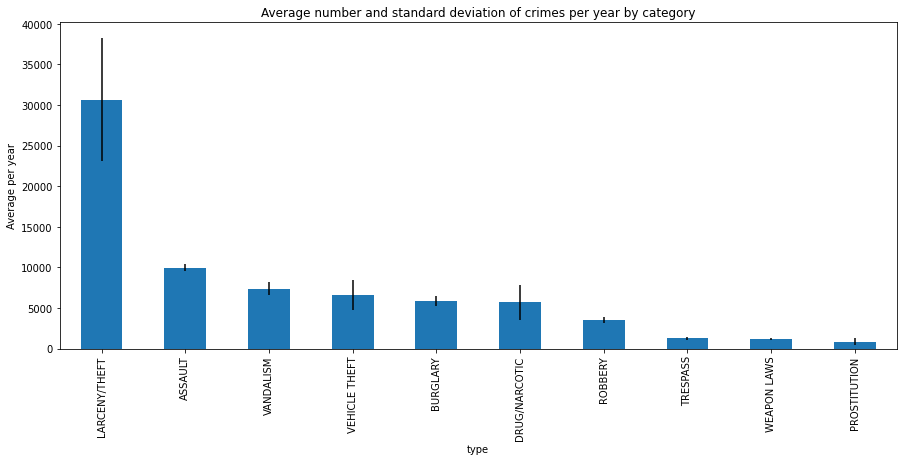

In [56]:
# Creating a df of only those top 10 crimes

df_crime_focus = df_crime[df_crime['Category'].isin(focus_crime)]

# Doing some math on it, taking the average and stdev for each type
crime_type_year_count = df_crime_focus[['Category', 'Year', 'IncidntNum']].groupby(['Category', 'Year'])['IncidntNum'].agg(lambda x: x.nunique()).reset_index()
average_per_type_sorted = crime_type_year_count.groupby('Category')['IncidntNum'].agg(['mean', 'std']).reset_index().sort_values('mean', ascending=False)

# And plotting
average_per_type_sorted.plot(x ='Category', y='mean', yerr='std', kind = 'bar', legend=None, \
title='Average number and standard deviation of crimes per year by category', xlabel='type', ylabel='Average per year', figsize=(15, 6))
plt.savefig('crimes/images/crime_category_avg_per_year_std_bar.png', bbox_inches='tight')

*Observations:* The figure illustrates the average number of crime incidents per year by category and their standard deviations as error bars. As standard deviation is the quantity expressing how much the members of a group differ from the mean value for the group, we can conclude here, that for the crimes in the *LARCENY/THEFT* category, the crime occurences per year somewhat differ from the mean of the yearly count. We can notice the same pattern in category *VEHICLE/THEFT* and *DRUG/NARCOTIC*, although in the rest of the cases the difference is not that significant.

* **Year-by-year development of the focus crime categories**
Another interesting area to investigate is the year-by-year development of the crime categories.

In [57]:
def crimes_yearly_dev():
    # Create bar charts displaying the year-by-year development of the focus crime types

    # Create list of df-s for each focus crime
    df_focus_type = [df_crime[df_crime['Category'] == category].groupby('Year')['IncidntNum'].count().reset_index().sort_values(by=['Year']) for category in focus_crime]

    # Define subplot props
    nr_cols = 5
    nr_rows = np.ceil(len(focus_crime)/nr_cols).astype(int)
    plt.figure(figsize=(30,12)) 

    # Generate subplots
    for index, type in enumerate(focus_crime):
        df_focus = df_focus_type[index]
        plt.subplot(nr_rows, nr_cols, index+1)
        #plt.xticks(rotation=x_rotation)
        plt.title(type, fontsize=10)
        plt.xlabel('Years', fontsize=12)
        plt.ylabel('Count', fontsize=12)
        plt.bar(df_focus['Year'].astype(int), df_focus['IncidntNum'], color=cmap(df_focus['IncidntNum'].values/df_focus['IncidntNum'].values.max()))


    plt.suptitle('Yearly development of police interactions in the focus types', fontsize=16)
    plt.tight_layout()
    plt.savefig('crimes/images/crime_type_yearly_dev_bar.png', bbox_inches='tight')
    plt.show()

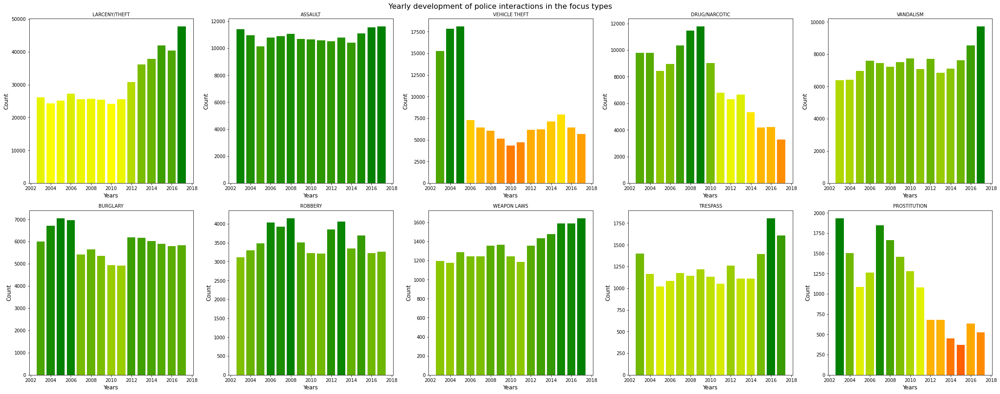

In [58]:
# Plot yearly development of crimes per category
crimes_yearly_dev()

*Observations:* Out of the 10 most common crime categories, 5 follows a similar trend and stays at a high number in each year. Although there are some categories we can highlight and investigate more:

* *LARCENY/THEFT:* As the first subfigure shows, crime occurences in the *LARCENY/THEFT* category follow a clear upwards trend over the years. In the first reported year, 2003, 'only' 25000 incidents were reported, while in the last year, 2017, the number of crimes almost reached 50000 in the year.
* *VEHICLE THEFT:* Vehicle theft was a quite common commited crime until 2006, when the number of crimes significantly dropped and remained under 9000 after that.
* *PROSTITUTION:* Prostitution rates was the highest in 2002, then decreased by 1000 cases in 2003. Unfortunately, it increased again in 2007, but gradually decreased by until 2015, when it has the lowest point with ~400 incidents in that year.

* **Outliers in total number of crimes occured per year using window rolling mean and window rolling standard deviation**
We could see from the previous analyzations that there are some year that were exceptional in terms of crime occurences. Therefore, next we investigate outliers across all crimes, not restricted to specific categories (but still within focus crime categories). The way we do that is calculating the outliers first with [window rolling calculations](https://towardsdatascience.com/dont-miss-out-on-rolling-window-functions-in-pandas-850b817131db) and finding months that fall outside of the boundaries. Then, we calculate the outliers again, but this time with the [IsolationForest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) algorithm and lastly we compare the 2 sets of months and investigate those specific dates that were found by both methods.

> So here we calculate the mean for 24 months rolling (moving) window and get the lower and upper threshold by extracting or adding the standard deviation of that window of the data. The we highlight the outliers that fall outside of the defined area. More info and examples for rolling calculations can be found [here](https://towardsdatascience.com/dont-miss-out-on-rolling-window-functions-in-pandas-850b817131db).

In [59]:
# Prepare df for visualizing outliers
df_crime_outliers = df_crime[["IncidntNum", "Date"]]

# Cut the date to months
df_crime_outliers["YearMonth"] = df_crime_outliers["Date"].dt.to_period('M').dt.to_timestamp()

df_crime_outliers = df_crime_outliers.groupby("YearMonth")["IncidntNum"].count().reset_index()
df_crime_outliers.set_index("YearMonth", inplace=True)

/shared-libs/python3.7/py-core/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



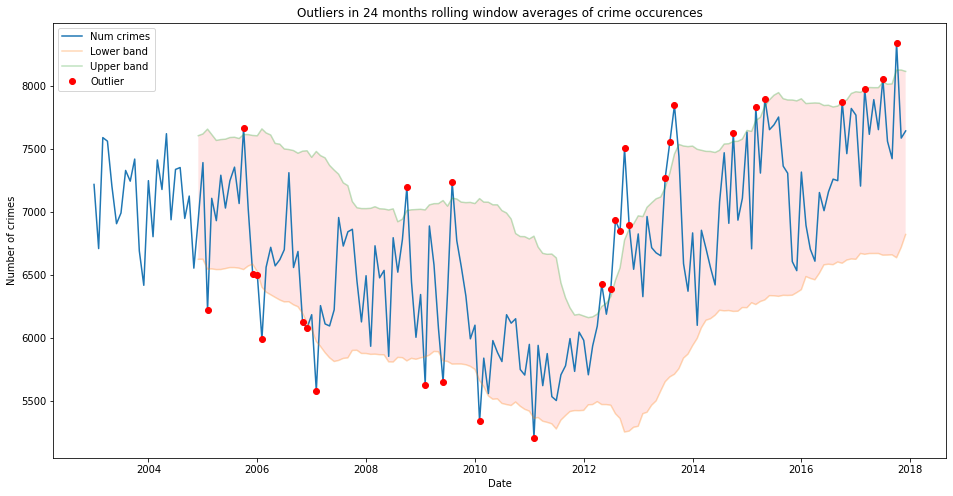

Num of outliers: 30
Num of all data points: 180


In [60]:
# Define a rolling window of 24 months (2 years)
window = 24

# Lambda function that returns with the upper and lower boundaries while rolling the window through the data
get_thresholds = lambda data: (data.rolling(window).mean() - 1.5 * data.rolling(window).std(), data.rolling(window).mean() + 1.5 * data.rolling(window).std())
lower_threshold, upper_threshold = get_thresholds(df_crime_outliers["IncidntNum"])

# Get the outliers
outliers_crimes = (df_crime_outliers["IncidntNum"] > upper_threshold) | (df_crime_outliers["IncidntNum"] < lower_threshold)

# Plot the rolling threshold area and outliers
fig, ax = plt.subplots(1,1, figsize=(16,8))

ax.plot(df_crime_outliers.index, df_crime_outliers, label="Num crimes")
ax.plot(df_crime_outliers.index, lower_threshold, label="Lower band", alpha=0.3)
ax.plot(df_crime_outliers.index, upper_threshold, label="Upper band", alpha=0.3)
ax.fill_between(df_crime_outliers.index, upper_threshold, lower_threshold, facecolor="red", alpha=0.1)
ax.plot(df_crime_outliers.index[outliers_crimes], df_crime_outliers[outliers_crimes], "ro", label="Outlier")
ax.set_xlabel("Date")
ax.set_ylabel("Number of crimes")
ax.set_title("Outliers in 24 months rolling window averages of crime occurences")
ax.legend()
plt.savefig('crimes/images/outliers_rolling_crime.png', bbox_inches='tight')
plt.show()

num_outliers = len(outliers_crimes[outliers_crimes])
num_data_points = len(df_crime_outliers)
print(f"Num of outliers: {num_outliers}\nNum of all data points: {num_data_points}")

*Observations:* Firstly, the boundaries are defined for a 24 months rolling window and with the help of this window's standard deviations, the lower theshold (by extracting the std from the mean) and upper threshold (by adding the std to the mean) are defined. The outliers are incidated with red dots on the plot and we can see that in the years of 2005, 2007, 2009 and 2013 exceptionally large amount of crimes happened compared to the average. There are other outliers as well, but they are not that significant. There are **30 outliers** in total out of the 180 total data points.

* **Finding the outliers with IsolationForest**
> Sklearn's [IsolationForest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) returns the anomaly score of each sample using the IsolationForest algorithm.
> We are calculating the outliers with another method as well and check the ones that were found by both methods.

In [61]:
# Executing the IsolationForest algorithm on a copy of the previous dataframe
df_crime_outliers_2 = df_crime_outliers.copy()

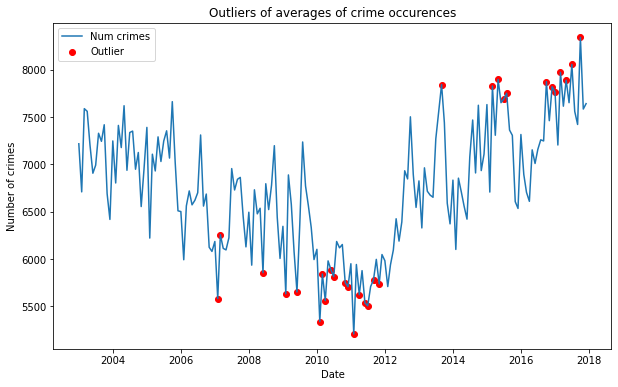

In [62]:
# Define franction of outliers that is needed for the isolationforest algorithm
outliers_fraction = (num_outliers)/num_data_points
scaler = StandardScaler()
np_scaled = scaler.fit_transform(df_crime_outliers_2.values.reshape(-1, 1))
data = pd.DataFrame(np_scaled)

# Create model and fit data
model = IsolationForest(contamination=outliers_fraction)
model.fit(data)

df_crime_outliers_2['anomaly'] = model.predict(data)

# Plot the outliers
fig, ax = plt.subplots(figsize=(10,6))

# Getting the outliers
outliers_iforest = df_crime_outliers_2.loc[df_crime_outliers_2['anomaly'] == -1, ['IncidntNum']]

ax.plot(df_crime_outliers_2.index, df_crime_outliers_2['IncidntNum'], label = 'Num crimes')
ax.scatter(outliers_iforest.index, outliers_iforest['IncidntNum'], color='red', label = 'Outlier')
ax.set_xlabel("Date")
ax.set_ylabel("Number of crimes")
ax.set_title("Outliers of averages of crime occurences")
plt.legend()
plt.savefig('crimes/images/outliers_iforest_crime.png', bbox_inches='tight')
plt.show()

*Observations:* The algorithm found 30 anomalies, but interestingly, these dates are different from the other 30 outliers found by the rolling method.

In [63]:
# Get the outliers that were found by both methods

# Sort values by date
outliers_iforest = outliers_iforest.sort_index()
outliers_crimes = outliers_crimes.sort_index()

# Get intersection of th 2 lists
matching_outliers_crimes = [date for date in outliers_iforest.index if date in outliers_crimes[outliers_crimes].index]

print("Outliers that both methods found:")
for match in matching_outliers_crimes:
    #date = datetime.strptime(match, '%MMM %y')
    print(f"Month: {match.strftime('%b, %Y')} Count: {outliers_iforest.loc[match]['IncidntNum']}")

Outliers that both methods found:
Month: Feb, 2007 Count: 5582
Month: Feb, 2009 Count: 5632
Month: Jun, 2009 Count: 5652
Month: Feb, 2010 Count: 5339
Month: Feb, 2011 Count: 5208
Month: Sep, 2013 Count: 7843
Month: Mar, 2015 Count: 7827
Month: May, 2015 Count: 7897
Month: Oct, 2016 Count: 7873
Month: Mar, 2017 Count: 7972
Month: Jul, 2017 Count: 8055
Month: Oct, 2017 Count: 8340


*Observations:* 12 months were found by both methods out of the 30 in total. There's no trend in the season when the peaks happened, there are cases in spring, summer, autumn and winter as well. Interestingly, 2017 is the year with the most peaks, which is consistent with the fact that that's the year with the most number of crimes. We can also notice that the number of crimes in the peak gradually increases as we're moving forward in time. That means that we need more and more crimes to fall outside of the defined threshold.

##### *Crimes per area*
Lastly, we analyse the location and distribution of the crimes in the city by visualizing them in Police Districts and calculating their density in 100mx100m squares of the city.

* **Visualising crimes per Police District**
A way to examine the crime rate in San Francisco is to visualize their distribution across the Police Districts.

In [64]:
# Calculate how many crimes happened in each district
df_crime_districts = df_crime.groupby('PdDistrict')['IncidntNum'].count().reset_index().sort_values(by=['IncidntNum'])
df_crime_districts = df_crime_districts.rename(columns={"IncidntNum": "Count"})

In [65]:
# Plot the map that indicates the number of crimes per police district
fig_c = px.choropleth_mapbox(df_crime_districts, geojson=districts, locations='PdDistrict', color='Count',
                           range_color=(df_crime_districts['Count'].min(), df_crime_districts['Count'].max()),
                           mapbox_style="carto-positron",
                           zoom=11, center = {"lat": 37.773972, "lon": -122.431297},
                           color_continuous_scale="Tealgrn",
                           opacity=0.4,
                           labels={'Value':'The parameter'}
                          )
fig_c.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig_c.write_html("crimes/maps/crime_count_district.html")
fig_c.show()

*Observations:* As the interactive map shows above, most of the crimes happened in the *SOUTHERN* district, with the exact number of 221.491k occurences. As we move towards the outside of the city, the less is the crime rate, for example in *RICHMOND* the number of crimes were only 65.28k. We can conclude here that most of the crimes happen in the inner city of San Francisco.

* **Divide SF crimes into a grid 100m*100m and show density**
Here we calculate the crime density for each sqaure in San Francisco, to see if we can recognize further patterns.

In [66]:
# Get counts in each square
crime_count, crime_lon, crime_lat = np.histogram2d(df_crime.Y, df_crime.X, bins = [130,125])

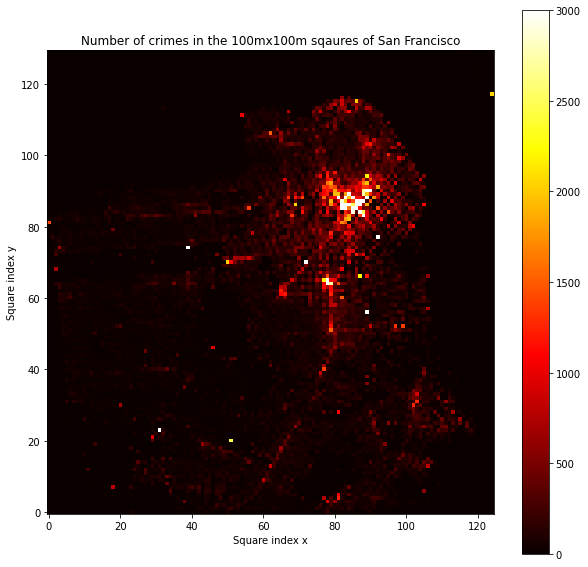

In [67]:
# Plot figure of 100mx100m squares
plt.figure(figsize=(10,10))
plt.xlabel('Square index x')
plt.ylabel('Square index y')
plt.title('Number of crimes in the 100mx100m sqaures of San Francisco')
plt.imshow(crime_count, cmap='hot',vmax=3000, origin='lower')
plt.colorbar()
plt.savefig('crimes/images/crime_density_100x100.png', bbox_inches='tight')
plt.show()

*Observations:* The figure illustrates the density of crimes in 100mx100m squares, the ligher the color, the higher the crime density in that area. 

As we have previously seen, the most dense area is still the inner city area of San Francisco. Otherwise the crimes are quite scattered, because the squares are shown with nearly black color outside of the inner city. Although we haven't found new patterns with this illstration, we can support the fact that most of the crimes happen in the area of the inner city.

#### Highlights of Basic stats of the crime dataset

San Francisco's crime dataset contains `1,064,315` crimes that fall into the defined focus categories. Most of the crimes happen in the inner city of San Francisco. The most common crime type in San Francisco is `LARCENY/THEFT` with `464,337` occurences. The year with the most crimes was `2017` with `92,696` incidents. On average, `80,978` crimes happened per year, `6,748 per month` and `221 per day`. 

*Yearly development of the most common categories and some highlights explained*

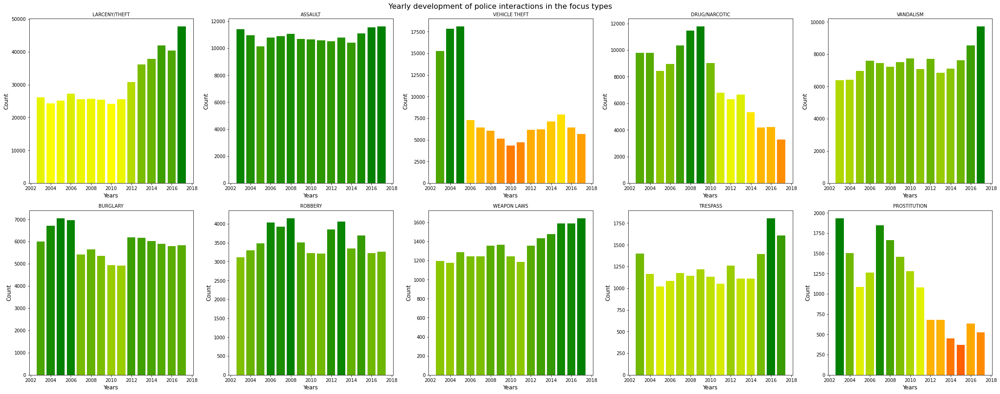

In [68]:
# Plot the yearly development of the crimes
crimes_yearly_dev()

*Observations:* Out of the 10 most common crime categories, 5 follows a similar trend and stays at a high number in each year. Although there are some categories we can highlight and investigate more:

* *LARCENY/THEFT:* As the first subfigure shows, crime occurences in the *LARCENY/THEFT* category follow a clear upwards trend over the years. In the first reported year, 2003, 'only' 25000 incidents were reported, while in the last year, 2017, the number of crimes almost reached 50000 in the year.
* *VEHICLE THEFT:* Vehicle theft was a quite common commited crime until 2006, when the number of crimes significantly dropped and remained under 9000 after that.
* *PROSTITUTION:* Prostitution rates was the highest in 2002, then decreased by 1000 cases in 2003. Unfortunately, it increased again in 2007, but gradually decreased by until 2015, when it has the lowest point with ~400 incidents in that year.

To conclude, fortunately, the crime dataset is well-maintained and includes location and category data, so we were able to create interesting visualisations. We learned about the different types of crimes happening in the city and see the trend of crime occurences each year and having some years with exceptionally high or low number of crimes. More insights about the data can be found on the project's [website](https://noramurakozy.github.io/SDA_web/).

## Data analysis

*Goal:* During the analysis, we expect to find results that can support the hypothesis, according to which, the more trees are planted the less crime incidents happen in a city. To find out, we create a correlation heatmap between tree density and crimes. Also, we use linear regression to see the correlation between number of crimes and trees per district and per month.

### Correlation per area - heatmap: tree density and crime occurences

Here we calculate the correlation between the tree density in a 100m*100m area and the number of crimes that are committed in the same area. We are using [Pearson correlation](https://en.wikipedia.org/wiki/Pearson_correlation_coefficient) since this is the default behaviour of numpy's [corrcoeff function](https://numpy.org/doc/stable/reference/generated/numpy.corrcoef.html).

In [69]:
from sklearn.preprocessing import normalize
# Get the correlation matrix of crimes and trees
corr_matrix = normalize(crime_count * trees_count)

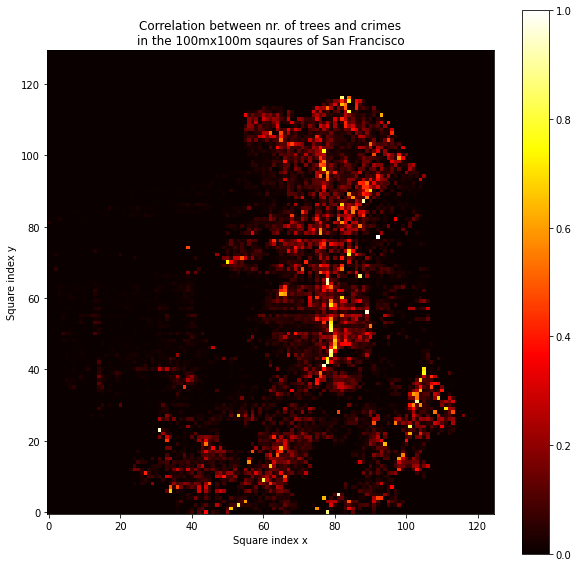

In [70]:
# Plot it as a heatmap
plt.figure(figsize=(10,10))
plt.xlabel('Square index x')
plt.ylabel('Square index y')
plt.title('Correlation between nr. of trees and crimes\nin the 100mx100m sqaures of San Francisco')
plt.imshow(corr_matrix, cmap='hot',vmax=1, origin='lower')
plt.colorbar()
plt.savefig('analysis/images/correlation_100x100.png', bbox_inches='tight')
plt.show()

*Observations:* We can see that some of the main streets of the city has high correlation between the trees and crimes. E.g. the middle part of San Jose Avenue has squares with relatively high correlation (more than 0.8), but we can't tell the same for the west coast of the city, where most of the sqaures has a correlation near to 0. The lighter the color, the higher the correlation.

In [71]:
# Low but positive correlation, more trees = more crimes
np.corrcoef(crime_count.ravel(), trees_count.ravel())

array([[1.        , 0.15133609],
       [0.15133609, 1.        ]])

*Observations*: The correlation between the two parameters can be extracted from the minor diagonal of the correlation matrix which is 0.1513. The correlation is positive, however it is too small to prove the link the crime rate to the number of trees. Positive correlation means that the increasing number of trees in an area indicates higher crime rate. It contradicts the articles that we have found and meantioned in the Introduction, or at least the pattern cannot be identified using these two dataset.

### Correlation in time: correlation between all planted trees and crimes commited per month

We inspect the correlation between the number of trees in San Francisco in a specific month and the number of crimes committed in that certain month. This means that the we are interested if the growing number of trees decreases the number of crimes commited over time.


Firstly we drop the records from the tree dataset where the plant date is missing. Then we group the records by year and month and calculate the cumulative sum for each.

In [72]:
df_trees_corr = df_trees[["TreeID", "Year", "Month"]]
df_trees_corr = df_trees_corr.dropna(axis=0, subset=["Year", "Month"])

df_trees_corr = df_trees_corr.groupby(["Year", "Month"])["TreeID"].count().cumsum().reset_index()
df_trees_corr.rename(columns={"TreeID": "Cumsum"}, inplace=True)

We group the crime records using the same logic but instead of calculating the cumulative sum for each month we just count the number of crimes committed in each month.


In [73]:
df_crime_corr = df_crime[["IncidntNum", "Year", "Month", "Category"]]
df_crime_corr = df_crime_corr[df_crime_corr["Category"].isin(focuscrimes)]
df_crime_corr = df_crime_corr.dropna(axis=0, subset=["Year", "Month"])

df_crime_corr = df_crime_corr.groupby(["Year", "Month"])["IncidntNum"].count().reset_index()
df_crime_corr.rename(columns={"IncidntNum": "Count"}, inplace=True)

Then we take the intersection of the two grouped datasets by time as we did in the linear regression part.

In [74]:
min_year = df_crime_corr["Year"].min()
min_month = df_crime_corr["Month"][df_crime_corr["Year"] == min_year].min()

max_year = df_crime_corr["Year"].max()
max_month = df_crime_corr["Month"][df_crime_corr["Year"] == max_year].max()

In [75]:
df_trees_corr = df_trees_corr[(df_trees_corr["Year"] >= min_year) & (df_trees_corr["Month"] >= min_month)]
df_trees_corr = df_trees_corr[(df_trees_corr["Year"] <= max_year) & (df_trees_corr["Month"] <= max_month)]

df_crime_corr.sort_values(by=["Year", "Month"], inplace=True)
df_trees_corr.sort_values(by=["Year", "Month"], inplace=True)

We calculate the Pearson correlation again between the number of crimes commited and the number of trees in San Francisco in each month.

In [76]:
crime_count = df_crime_corr["Count"].to_numpy()
tree_count = df_trees_corr["Cumsum"].to_numpy()

In [77]:
corr = np.corrcoef(crime_count, tree_count)[0][1]
print(f"The correlation between the number of trees in SF per month and the number of crimes commited per month is {corr:.4f}")

The correlation between the number of trees in SF per month and the number of crimes commited per month is 0.1163


*Observations*: The correlation betweeen the two parameters is 0.1163 which is a similar behaviour that we have experienced in the previous parts. The small correlation indicates that the growing number of trees in San Francisco has a minor affect on the crimes committed in the city.

### Linear regression

Here we analyse and look for further patterns using linear regression to find the connection between crime rate and tree density per month and per police district. We also plot the results of the linear regression so the reader gets an instant insight into the correlations.

#### Nr. of crimes vs nr. of trees planted in a month

First we examine if there's any connection between the number of trees planted in a month and the number of reported crimes per category.

*Grouping tree dataframe by monthly plant*

We drop the records from the tree dataset where date is njot specified. Then we group the records based on their year and month so we end up with a dataframe where each record specifies the number of planted trees for a given month.

In [78]:
df_trees_ml = df_trees[["TreeID", "Year", "Month", "Day"]]
# Drop trees without date
df_trees_ml = df_trees_ml.dropna(axis=0, subset=["Year", "Month", "Day"])

# Create a dataframe for each month in the years
df_trees_ml_monthly = df_trees_ml.groupby(["Year", "Month"])["TreeID"].count().reset_index()
df_trees_ml_monthly.rename(columns={"TreeID": "Count"}, inplace=True)
df_trees_ml_monthly["Year"] = df_trees_ml_monthly["Year"].astype(int)
df_trees_ml_monthly["Month"] = df_trees_ml_monthly["Month"].astype(int)

*Grouping the crime dataframe by number of crimes committed by month*

We filter the data which are in our predefined focus crimes and drop the records where the date is a missing parameter. Then we group the crimes in the same way as we did with the trees above.

In [79]:
# Coduct the same process on crimes as for trees above
df_crime_ml = df_crime[["IncidntNum", "Year", "Month", "Day", "Category"]]
df_crime_ml = df_crime_ml.dropna(axis=0, subset=["Year", "Month", "Day"])

df_crime_ml_monthly = df_crime_ml.groupby(["Year", "Month", "Category"])["IncidntNum"].count().reset_index()
df_crime_ml_monthly.rename(columns={"IncidntNum": "Count"}, inplace=True)

We extract the minimum (*min_year*, *min_month*) and the maximum date (*max_year*, *max_month*) that are available in the crime dataset since this one comprehend a smaller time interval.

In [80]:
min_year = df_crime_ml_monthly["Year"].min()
min_month = df_crime_ml_monthly["Month"][df_crime_ml_monthly["Year"] == min_year].min()

max_year = df_crime_ml_monthly["Year"].max()
max_month = df_crime_ml_monthly["Month"][df_crime_ml_monthly["Year"] == max_year].max()

We reduce the size of the grouped tree dataset so the time interval of both dataset matches.

In [81]:
df_trees_ml_monthly = df_trees_ml_monthly[(df_trees_ml_monthly["Year"] >= min_year) & (df_trees_ml_monthly["Month"] >= min_month)]
df_trees_ml_monthly = df_trees_ml_monthly[(df_trees_ml_monthly["Year"] <= max_year) & (df_trees_ml_monthly["Month"] <= max_month)]

In [82]:
df_crime_ml_monthly.sort_values(by=["Year", "Month"], inplace=True)
df_trees_ml_monthly.sort_values(by=["Year", "Month"], inplace=True)

We go through each focus crime and try to fit a linear function on top of the tree and the crime data points. The axes of all figures specifies the number of trees planted/number of crimes committed in a specific month e.g.: number of crimes committed and the number of trees planted in April 2010. 

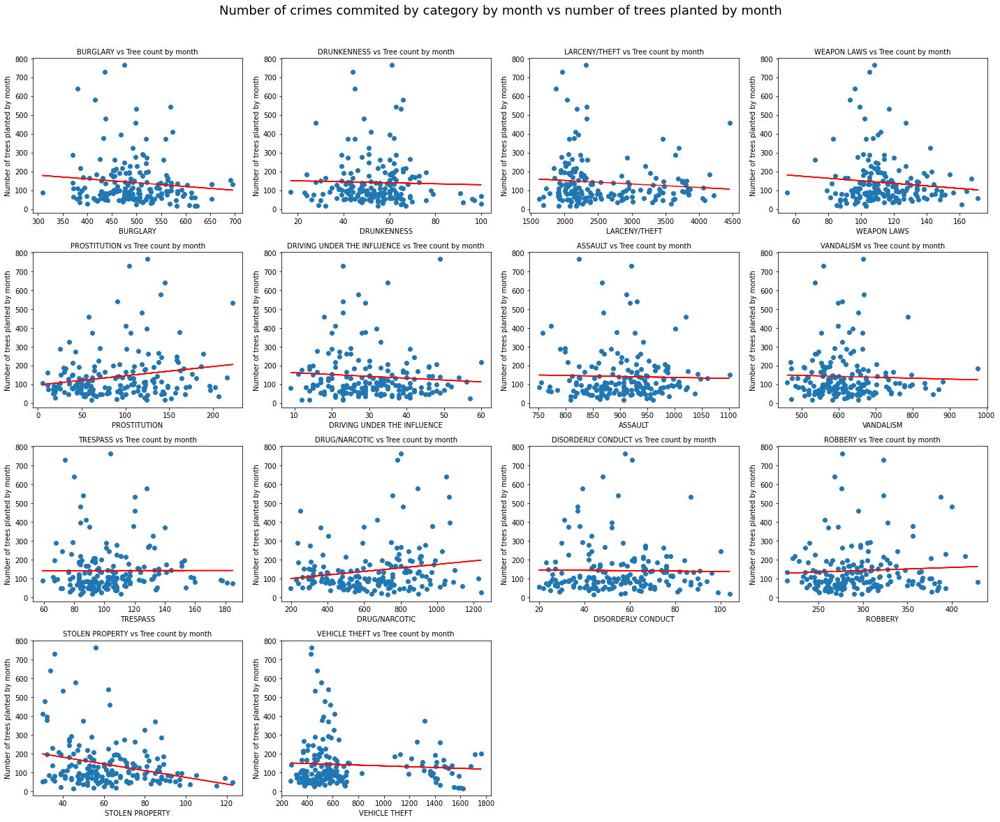

In [83]:
from sklearn.linear_model import LinearRegression

num_crimes = len(df_crime_ml_monthly["Category"].unique())

nr_cols = 4
nr_rows = np.ceil(num_crimes/nr_cols).astype(int)
plt.figure(figsize=(20,16))

tree_count = df_trees_ml_monthly["Count"].to_numpy()

for index, crime_type in enumerate(focuscrimes):
    crime_count = df_crime_ml_monthly[df_crime_ml_monthly["Category"] == crime_type]["Count"].to_numpy()
    reg = LinearRegression().fit(crime_count.reshape(-1,1), tree_count)
    slope = reg.coef_
    intercept = reg.intercept_
    plt.subplot(nr_rows, nr_cols, index+1)
    plt.title(crime_type + ' vs Tree count by month' , fontsize=10)
    plt.xlabel(crime_type, fontsize=10)
    plt.ylabel("Number of trees planted by month", fontsize=10)
    plt.scatter(crime_count, tree_count)
    plt.plot(crime_count, slope*crime_count + intercept, 'r')

plt.suptitle('Number of crimes commited by category by month vs number of trees planted by month', fontsize=18, y=1.02)
plt.tight_layout()
plt.savefig('analysis/images/lin_reg_monthly.png', bbox_inches='tight')
plt.show()

*Observations*: In most cases we can hardly say there is linear connection between the two parameters. The previusly calculated correlation confirms this observation. Suprisingly the slope of the linear functions are negative on most of the figures which argues the correlation value. Negative slope means larger number of crimes corresponds to less trees planted in a month which is the same pattern the cited articles have discovered.

#### Nr. of crimes in a Police District vs nr. of trees planted

Next, we look at the correlation between number of crimes and trees planted in Police Districts.

We apply the same transformations as in the previous sections but we add the police district ot each record so we end up with grouped datasets for both number of crimes and number of trees planted in a given month by police district.

In [84]:
df_trees_ml2 = df_trees[["TreeID", "Year", "Month", "Day", "Police Districts"]]
df_trees_ml2 = df_trees_ml2.dropna(axis=0, subset=["Year", "Month", "Day", "Police Districts"])

df_trees_ml2_monthly = df_trees_ml2.groupby(["Year", "Month", "Police Districts"])["TreeID"].count().unstack(fill_value=0).stack().reset_index()
df_trees_ml2_monthly.rename(columns={0: "Count"}, inplace=True)
df_trees_ml2_monthly["Year"] = df_trees_ml2_monthly["Year"].astype(int)
df_trees_ml2_monthly["Month"] = df_trees_ml2_monthly["Month"].astype(int)

In [85]:
df_crime_ml2 = df_crime[["IncidntNum", "Year", "Month", "Day", "PdDistrict", "Category"]]
df_crime_ml2 = df_crime_ml2[df_crime_ml2["Category"].isin(focuscrimes)]
df_crime_ml2 = df_crime_ml2.dropna(axis=0, subset=["Year", "Month", "Day", "PdDistrict"])

df_crime_ml2_monthly = df_crime_ml2.groupby(["Year", "Month", "PdDistrict"])["IncidntNum"].count().reset_index()
df_crime_ml2_monthly.rename(columns={"IncidntNum": "Count"}, inplace=True)

In [86]:
min_year = df_crime_ml2_monthly["Year"].min()
min_month = df_crime_ml2_monthly["Month"][df_crime_ml2_monthly["Year"] == min_year].min()

max_year = df_crime_ml2_monthly["Year"].max()
max_month = df_crime_ml2_monthly["Month"][df_crime_ml2_monthly["Year"] == max_year].max()

In [87]:
df_trees_ml2_monthly = df_trees_ml2_monthly[(df_trees_ml2_monthly["Year"] >= min_year) & (df_trees_ml2_monthly["Month"] >= min_month)]
df_trees_ml2_monthly = df_trees_ml2_monthly[(df_trees_ml2_monthly["Year"] <= max_year) & (df_trees_ml2_monthly["Month"] <= max_month)]

In [88]:
df_crime_ml2_monthly.sort_values(by=["Year", "Month"], inplace=True)
df_trees_ml2_monthly.sort_values(by=["Year", "Month"], inplace=True)

We go through each police district and try to fit a linear function on top of the tree and the crime data points. The axes of all figures specifies the number of trees planted/number of crimes committed in a specific month in certain police districte.g.: number of crimes committed and the number of trees planted in April 2010 in Tenderloin. 

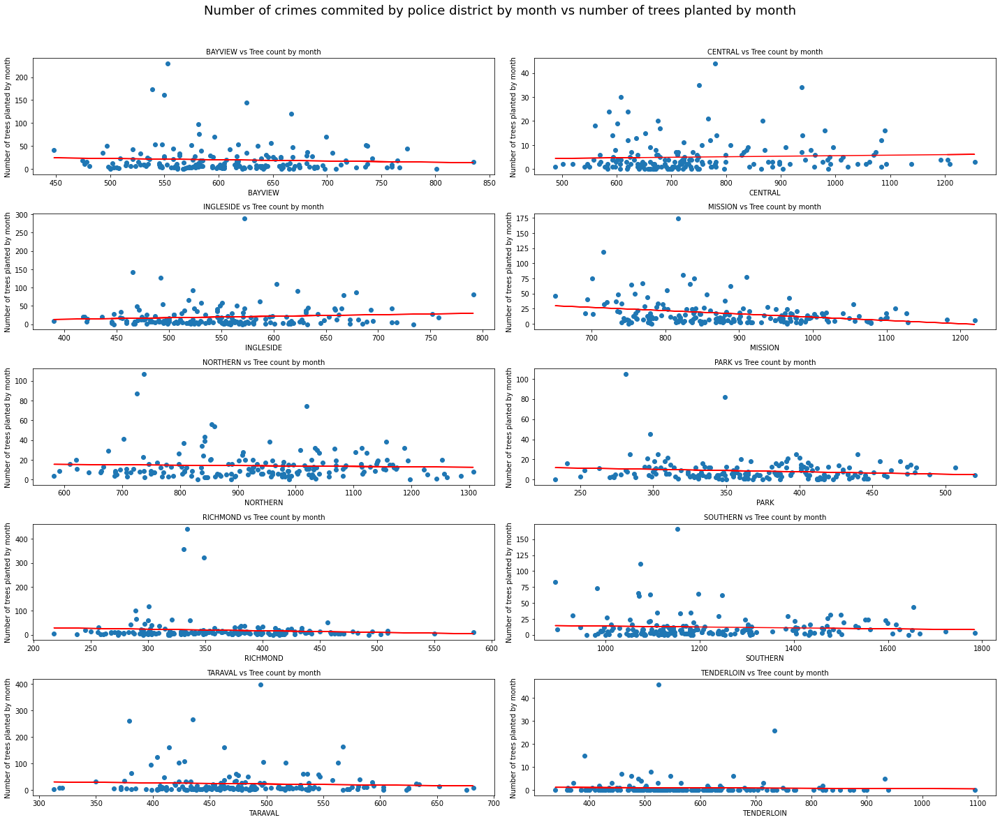

In [89]:
from sklearn.linear_model import LinearRegression

districts = df_crime_ml2_monthly["PdDistrict"].unique()
num_districts = len(districts)

nr_cols = 2
nr_rows = np.ceil(num_districts/nr_cols).astype(int)
plt.figure(figsize=(20,16))

for index, district in enumerate(districts):
    crime_count = df_crime_ml2_monthly[df_crime_ml2_monthly["PdDistrict"] == district]["Count"].to_numpy()
    tree_count = df_trees_ml2_monthly[df_trees_ml2_monthly["Police Districts"] == district]["Count"].to_numpy()
    reg = LinearRegression().fit(crime_count.reshape(-1,1), tree_count)
    slope = reg.coef_
    intercept = reg.intercept_
    plt.subplot(nr_rows, nr_cols, index+1)
    plt.title(district + ' vs Tree count by month' , fontsize=10)
    plt.xlabel(district, fontsize=10)
    plt.ylabel("Number of trees planted by month", fontsize=10)
    plt.scatter(crime_count, tree_count)
    plt.plot(crime_count, slope*crime_count + intercept, 'r')


plt.suptitle('Number of crimes commited by police district by month vs number of trees planted by month', fontsize=18, y=1.02)
plt.tight_layout()
plt.savefig('analysis/images/lin_reg_pdDistrict.png', bbox_inches='tight')
plt.show()

*Observations*: On most figures it would seem that the linear fit describes the connection between the two parameters but if we take a closer look we can see that the number of trees equal to zero which means we are lacking of data where the police district is specified regarding the filtered tree dataset.   

In [90]:
df_trees_ml2_monthly_zeros = df_trees_ml2_monthly[df_trees_ml2_monthly["Count"] == 0]
df_trees_ml2_monthly_small = df_trees_ml2_monthly[df_trees_ml2_monthly["Count"] < 10]

print(f"Number of records where the number of planted trees less than 10: {len(df_trees_ml2_monthly_small)}")
print(f"Number of records where the number of planted trees equals to zero: {len(df_trees_ml2_monthly_zeros)}")
print(f"Number of records: {len(df_trees_ml2_monthly)}")

Number of records where the number of planted trees less than 10: 1123
Number of records where the number of planted trees equals to zero: 230
Number of records: 1800


There are 230 records in the filtered tree dataset where the number of planted trees in a month in a certain police district is zero. It is more than 12% of the whole dataset. In addition, there are 1123 records where the planted trees' number is less than 10 in a month in a police district. It seems that the police district is usually not recorded in the tree dataset which is the root cause for the results above.

## Genre

* Which genre of data story did you use?
The most important building block of our data story is the "Annotated chart" genre since it seemed to be the most obvious choice for scientific purposes. Using this genre we could display bar plots, scatter plots, heatmaps and so on that all contributed to guiding the reader through the whole story. We also included some "Magazine" elements where we embedded an image in a page of text.

* Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?
For "Visual Structuring", our data story is functioning as a "Consistent Visual Platform" because the reader needs to understand each step and both datasets (tree, crime) until the very end when we are using linear regression which requires a higher level of understanding of the problem.

For "Highlighting", we used mostly feature distinction on static images and zooming on interactive images. The reader could explore some aspects of the dataset by himself/herself when interacting with an interactive image. While using static images enabled us to point out some specific attributes of each dataset.

Using animated transitions when showing the number of trees planted for each year was the main tool from "Transition Guidance". The continuous changes in the video help the reader to get a general overview of the development of the trees in San Francisco.

* Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?
Our data story is presented in a linear way which is corresponding to the linear ordering under the "Narrative Structure". Since we are introducing higher-level concepts throughout the story, the reader needs to be guided.

For "Interactivity", we are using the `plotly` library to make interactive images where the possible actions are limited to navigations usually. There are static images as well in the story which do not add to the overall interactive experience.

Our story is written in a narrative structure including "Introduction" and "Conclusion". We also added headers/headlines when the text moved to another topic. We cited some articles and papers where we referenced them as an accompanying article. All these things are useful and efficient tools for "Messaging" because it makes the story more readable and helps the reader to connect the different parts of the story.

## Discussion and conclusion - Nóra

Overall, we did a throrough analysis on both datasets to get familiar with them and have insightful visulalization that helps to understand the data for the user as well. We also tried to produc as many interactive visualisations as possible, so the user can explore the data in more detail while experiencing a better UX, and not only looking at images.

Although, since there is no data about trees in the parks (because they are not street trees and probably are maintained by another organization than the author of our dataset), we do not have information about crimes happening in parks and their correlation with the tree density. It might have chenged the results a bit, but probably not significantly. It's quite surprising as well, that our results show that the more trees are planted in an area, the more crimes occured there. It's important to mention that the correlation was positive, but really low. So we can say that the more trees are planted the more crimes happen in an area, but since the correlation is really low, it's not enough to prove a clear link between trees and crimes. Which is not the result we would expect at first, also because of our inspiration project, the [Urban Forest Plan](https://sfplanning.org/urban-forest-plan) in San Francisco, where they mentioned lower crime rate as a possible benefit of planting trees. On their site, they cited 2 papers that investigated this topic in 2 other cities in the US, but it seems like planting trees did not help in the case of San Francisco, which is an interesting conclusion in the end, since that's not what a person would expect.

An explanation could be that criminals can hide better in areas where trees are densly planted or they just simply don't care about their surroundings and will commit the crime anyways.

To summarize, it was an interesting topic to analyse and investigate, and we enjoyed the process, despite the surprising results. It seems like the government in San Francisco has to look for other solutions to lower crime rate in the city.

## Contributions

* Nóra Gyopár Muraközy (s202222):
    * Website setup
    * Tree dataset analysis
    * Tree dataset story
    * Introduction, Conclusion
    * Final formatting
    * Cleanup (both notebook and website)
* Ferenc Leicht (s202583):
    * Linear regressions
    * Data analysis
    * Outlier detection
    * Preprocessing
    * Genre
* Páll Guðbrandsson (s220149):
    * Crime Dataset analysis & story
    * Dataset research
        * Unsuccessfully contacted authorities in Copenhagen for local data before pivoting to SF
    

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=b739fa34-1570-48ed-9aee-5cc9c6d420da' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>